# 프로젝트 : 이미지 생성하기

개요 :
- GAN(Generative Adversarial Network)모델을 이용
- CIFAR-10 데이터셋을 대상으로 유사한 이미지 만들기

목표 :
- 육안으로 구분할 수 있는 수준의 오브젝트 생성
- 생성 이미지의 점진적 향상을 확인
    - gif를 통한 시각적 확인
    - 0.5 근처로 수렴하는 fake accuracy
- 결과물 개선을 위한 제안과 반영

## 목차
0. 기본 준비
1. 데이터 준비 및 전처리
2. 모델 구성
3. 학습 과정 구성 및 학습
4. 개선 제안 및 결과
5. 마치며

## 0. 기본 준비

In [ ]:
!pip install --upgrade IPython

     |████████████████████████████████| 792 kB 5.3 MB/s 
     |████████████████████████████████| 380 kB 55.2 MB/s 
  Attempting uninstall: prompt-toolkit
    Found existing installation: prompt-toolkit 1.0.18
    Uninstalling prompt-toolkit-1.0.18:
      Successfully uninstalled prompt-toolkit-1.0.18
  Attempting uninstall: IPython
    Found existing installation: ipython 5.5.0
    Uninstalling ipython-5.5.0:
      Successfully uninstalled ipython-5.5.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
jupyter-console 5.2.0 requires prompt-toolkit<2.0.0,>=1.0.0, but you have prompt-toolkit 3.0.28 which is incompatible.
google-colab 1.0.0 requires ipython~=5.5.0, but you have ipython 7.31.1 which is incompatible.


In [ ]:
%pip install imageio
%pip install Pillow

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import os
import glob
import time

import PIL
import imageio
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers
from IPython import display
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
%mkdir -p /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/ex
%mkdir -p /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/ex/generated_samples
%mkdir -p /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/ex/training_checkpoints
%mkdir -p /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/ex/training_history

In [ ]:
plt.style.use(['dark_background'])

In [ ]:
path = '/content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/'

In [ ]:
os.listdir(path)

['ex', 'try']

## 1. 데이터 준비 및 전처리

### 1.1. 데이터셋 로드

In [81]:
# 언더스코어를 활용해 라벨 데이터는 무시하고 데이터셋을 변수에 저장
cifar10 = tf.keras.datasets.cifar10

(train_x, _), (test_x, _) = cifar10.load_data()

train_x.shape

(50000, 32, 32, 3)

In [82]:
# 픽셀값 확인
print("max pixel:", train_x.max())
print("min pixel:", train_x.min())

max pixel: 255
min pixel: 0


채널 수에 대한 전처리, 즉 reshape은 따로 필요하지 않아 보인다.

확인해보자

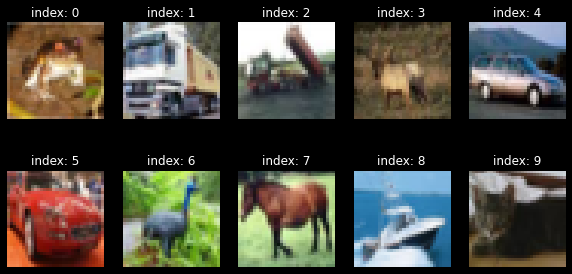

In [83]:
plt.figure(figsize=(10, 5))

for i in range(10):
    plt.subplot(2, 5, i+1)
    plt.imshow(train_x[i])
    plt.title(f'index: {i}')
    plt.axis('off')
plt.show()

### 1.2. 전처리

In [84]:
train_x = (train_x - 127.5) / 127.5

# 이미지를 [-1, 1]로 정규화합니다.

print("max pixel:", train_x.max())
print("min pixel:", train_x.min())

max pixel: 1.0
min pixel: -1.0


정규화 처리를 0에서 1 사이의 값이 아닌 -1~1로 하는 이유는 무엇일까?

이후 모델을 구현하는 단계에서 확인해 볼 수 있는데, 활성화 함수와 관련이 있어 보인다.

생성자와 판별자 모두 은닉레이어에서 LeakyReLU를 사용한다.

0 이하의 값에서도 작은 기울기 값을 주어, 검은색에 가까운 픽셀들에 대해서 조금 더 정교한 처리를 기대할 수 있을 것 같다.

생성자가 만들어 전달하는 노이즈 값의 아웃풋 역시 하이퍼볼릭탄젠트(tanh)를 사용한다.

In [85]:
train_x.shape

(50000, 32, 32, 3)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

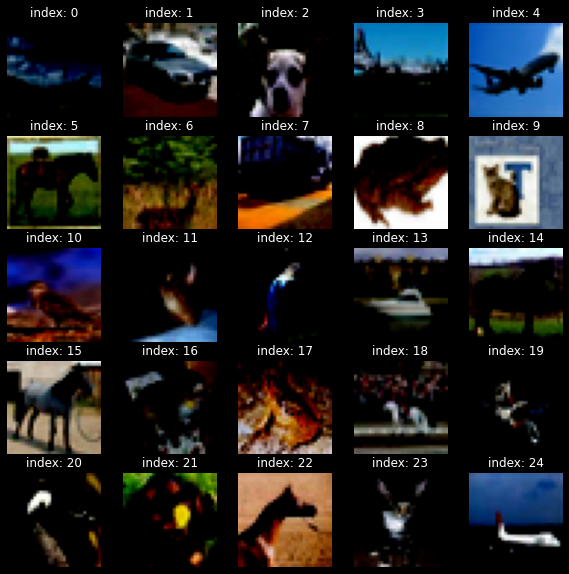

In [86]:
# 25개 확인 
plt.figure(figsize=(10, 10))

sample = np.random.choice(np.arange(train_x.shape[0]), size=25, replace=False)
sample = sample.tolist()
for i in range(len(sample)):
    plt.subplot(5, 5, i+1)
    plt.imshow(train_x[sample[i]])
    plt.title(f'index: {i}')
    plt.axis('off')
plt.show()

정규화의 영향으로 시각화 했을 때 색상에 왜곡이 있다. 

최종 출력에서는 형태가 달라져야 할 것.

In [87]:
# f-mnist 데이터셋의 6만개여도 원본보다 커서 큰 상관은 없지만...
# 데이터 샘플의 총 갯수와 동일하게 버퍼사이즈를 지정해준다. 

BUFFER_SIZE = 50000
BATCH_SIZE = 256

In [88]:
train_dataset = tf.data.Dataset.from_tensor_slices(train_x).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

## 2. GAN 모델 구성(예제 모델 카피)

GAN 모델은

- Generator(생성자)

- Discriminator(판별자 또는 구분자)

의 두 갈래의 네트워크로 구성되어있다.

역할이 다른 두 모델이 학습의 결과물을 주고받으며 적대적 성장하는 형태.


### 2.1. 생성자 모델

In [ ]:
def make_generator_model():

    model = tf.keras.Sequential()

    model.add(layers.Dense(4*4*256, use_bias=False, input_shape=(100,)))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Reshape((4, 4, 256)))

    model.add(layers.Conv2DTranspose(128, kernel_size=(5, 5), strides=(2, 2), padding='same', use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Conv2DTranspose(64, kernel_size=(5, 5), strides=(2, 2), padding='same', use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    # 출력 결과물이 RGB채널을 갖기 위해서 3차원 백터가 필요하다.
    model.add(layers.Conv2DTranspose(3, kernel_size=(5, 5), strides=(2, 2), padding='same', use_bias=False, \
                                     activation='tanh'))

    return model

In [ ]:
generator = make_generator_model()

generator.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 4096)              409600    
                                                                 
 batch_normalization (BatchN  (None, 4096)             16384     
 ormalization)                                                   
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 4096)              0         
                                                                 
 reshape (Reshape)           (None, 4, 4, 256)         0         
                                                                 
 conv2d_transpose (Conv2DTra  (None, 8, 8, 128)        819200    
 nspose)                                                         
                                                                 
 batch_normalization_1 (Batc  (None, 8, 8, 128)        5

마지막 Conv2DT 레이어의 shape이 (None, 32, 32, 3)임을 확인

In [ ]:
# 100이라는 숫자가 어디서 나왔는지 궁금했었는데 노이즈 구성의 일반적(관습적)인 형태인 것 같음
noise = tf.random.normal([1, 100])

In [ ]:
# 노이즈 지금 학습시킬 것이 아님!
generated_image = generator(noise, training=False)
# batch size=1, shape=(32,32,3)
generated_image.shape

TensorShape([1, 32, 32, 3])

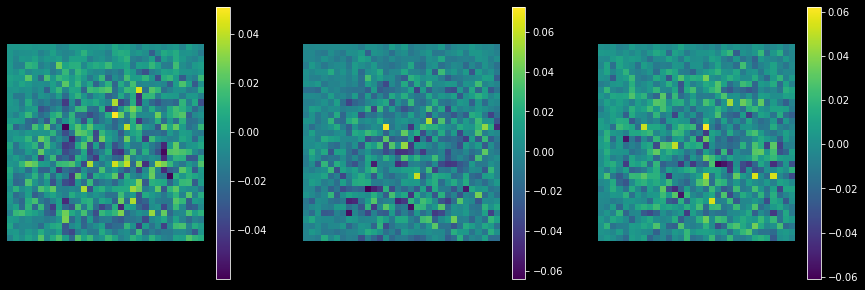

In [ ]:
# 노이즈 벡터 이미지를 구경해보자. 의미는..없지만?
#
plt.figure(figsize=(15, 5))

for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.imshow(generated_image[0, :, :, i])
    plt.colorbar()
    plt.axis('off')
plt.show()

### 2.2. 판별자 모델

: '진짜라고 판단하는 정도'값을 출력해야 한다.

입력은 원본 데이터와 같은 (32, 32, 3) 크기의 이미지로,

출력은 단 하나의 숫자(진짜라고 판단하는 정도)가 될 것이다.

In [ ]:
def make_discriminator_model():

    model = tf.keras.Sequential()

    # input shape만 조절.
    model.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same', input_shape=[32, 32, 3]))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))

    model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))

    model.add(layers.Flatten())

    # 출력은 그대로 1이다.
    model.add(layers.Dense(1))

    return model

In [ ]:
discriminator = make_discriminator_model()

discriminator.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 16, 16, 64)        4864      
                                                                 
 leaky_re_lu_3 (LeakyReLU)   (None, 16, 16, 64)        0         
                                                                 
 dropout (Dropout)           (None, 16, 16, 64)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 8, 8, 128)         204928    
                                                                 
 leaky_re_lu_4 (LeakyReLU)   (None, 8, 8, 128)         0         
                                                                 
 dropout_1 (Dropout)         (None, 8, 8, 128)         0         
                                                                 
 flatten (Flatten)           (None, 8192)             

In [ ]:
decision = discriminator(generated_image, training=False)
decision

<tf.Tensor: shape=(1, 1), dtype=float32, numpy=array([[-0.00069819]], dtype=float32)>

### 2.3. 손실함수

- GAN은 손실함수로 교차 엔트로피(Cross Entropy)를 사용


- 특히 판별자는 한 개의 이미지가 가짜인지 진짜인지 나타내는 2개 클래스 간 분류 문제를 풀어야 하므로, 이진 교차 엔트로피(binary cross entropy)를 사용


- 생성자와 판별자의 역할 리마인드
> - 생성자 : 판별자가 Fake Image에 대해 판별한 값, 즉 D(fake_image) 값이 1에 가까워지는 것
> - 판별자 : Real Image 판별값, 즉 D(real_image)는 1에, Fake Image 판별값, 즉 D(fake_image)는 0에 가까워지는 것

#### Cross Entropy
- 케라스에 내장된 BinaryCrossEntropy는 0과 1 사이의 확률분포를 input으로 받는 것을 상정하고 있다.
- 하지만 판별자의 마지막 레이어에는 활성화함수 등 관련 처리가 없다.
- 따라서 모든 실수값이 손실 함수의 input으로 들어올 수 있으며, 이에 관해 하이퍼파라미터를 조절해야 한다.

In [ ]:
# input을 먼저 0~1로 정규분포화해주는 인자(값) - from_logits=True
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

로스값 계산 대상
- fake_output : 생성자가 생성한 Fake Image를 구분자에 입력시켜서 판별된 값, 즉 D(fake_image)
- real_output : 기존에 있던 Real Image를 구분자에 입력시켜서 판별된 값, 즉 D(real_image)

>생성자가 생성한 이미지에 대해, 생성자와 판별자는 반대의 결과를 기대한다.<br> 
>앞서 위조지폐의 비유를 사용하면 생성자는 진짜(1)로 판별하길 기대할 것이고,<br> 
>판별자는 가짜(0)를 구분해내길 기대할 것이다.

결과적으로 fake_output이라는 같은 대상에 대해 각각의 로스값은 반대 방향, 즉 적대적이다.

계산의 아이디어 자체는 간단하다.

1. 이미지와 동일한 shape의 ones, zeros 배열을 만들고,
2. 생성자와 판별자 각각에서 교차 엔트로피로 비교한다.

#### 2.3.1. 생성자에 대한 손실함수

In [ ]:
def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

#### 2.3.2. 판별자에 대한 손실함수

In [ ]:
# 판별자는 real_input에 대해서도 손실을 계산해야한다.
# 진본이기 때문에, 비교 대상은 당연히 1이다.
# 반면 생성된 아웃풋에 대해서는 zeros를 기준으로 손실을 측정한다.
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

### 2.4. 정확도

: 생성 모델의 관점에서, 판별자의 정확도가 높은 것은 기본적으로 좋지 못한 지표이다. 이는 즉, 생성자의 아웃풋이 원본과 유사성이 낮다는 뜻이기 때문이다. 

- 판별자의 정확도가 학습에 따라, 1.0에서 시작해 0.5에 수렴하는 것이 fake_output의 원본과의 유사도를 확일할 때 가장 이상적인 지표가 될 것.

In [ ]:
def discriminator_accuracy(real_output, fake_output):
    real_accuracy = tf.reduce_mean(tf.cast(tf.math.greater_equal(real_output, tf.constant([0.5])), tf.float32))
    fake_accuracy = tf.reduce_mean(tf.cast(tf.math.less(fake_output, tf.constant([0.5])), tf.float32))
    return real_accuracy, fake_accuracy

ex) real_output = tf.Tensor([0.2, 0.4, 0.7, 0.9]) 라면,

- (1) tf.math.greater_equal(real_output, tf.constant([0.5]) 
<br>: real_output의 각 원소가 0.5 이상인지 True, False로 판별 - >> tf.Tensor([False, False, True, True])
- (2) tf.cast( (1), tf.float32) 
<br>: (1)의 결과가 True이면 1.0, False이면 0.0으로 변환 - >> tf.Tensor([0.0, 0.0, 1.0, 1.0])
- (3) tf.reduce_mean( (2)) 
<br>: (2)의 결과를 평균내어 이번 배치의 정확도(accuracy)를 계산 - >> 0.5

### 2.5. 옵티마이저

잘 모르면 Adam(..)

예제에서도 Adam(..)

> GAN에 관해 검색 해봐도 Adam 옵티마이저를 사용했거나, 잘 작동한다는 연구결과들이 많다.

In [ ]:
# 학습률은 변경시켜 볼 것
generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

## 3. 학습 과정 구성 및 학습

### 3.1. 학습 과정 시각화 샘플

In [ ]:
noise_dim = 100
num_examples_to_generate = 16

seed = tf.random.normal([num_examples_to_generate, noise_dim])
seed.shape

TensorShape([16, 100])

### 3.2. train_step

In [ ]:
@tf.function
def train_step(images):  #(1) 입력데이터
    noise = tf.random.normal([BATCH_SIZE, noise_dim])  #(2) 생성자 입력 노이즈

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:  #(3) tf.GradientTape() 오픈
        generated_images = generator(noise, training=True)  #(4) generated_images 생성

        #(5) discriminator 판별
        real_output = discriminator(images, training=True)
        fake_output = discriminator(generated_images, training=True)

        #(6) loss 계산
        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

        #(7) accuracy 계산
        real_accuracy, fake_accuracy = discriminator_accuracy(real_output, fake_output) 
    
    #(8) gradient 계산
    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    #(9) 모델 학습
    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

    return gen_loss, disc_loss, real_accuracy, fake_accuracy  #(10) 리턴값

### 3.3. 샘플 확인
- model이 16개의 seed가 들어있는 sample_seeds를 입력받아서 만들어낸 prediction을 matplotlib으로 시각화해주는 과정
- 총 16개의 sample을 시각화. 4행 4열로 나타내기위해 subplot(4, 4, :i+1)으로 지정
- plt에 저장되어 보이는 이미지를 plt.savefig로 간단히 파일로 저장(savefig)
- 전처리 과정에서 -1 ~ 1 사이로 정규화 했던 픽셀 값들을 복구시켜준다.

In [ ]:
def generate_and_save_images(model, epoch, it, sample_seeds):

    predictions = model(sample_seeds, training=False)

    fig = plt.figure(figsize=(4, 4))
    for i in range(predictions.shape[0]):
        plt.subplot(4, 4, i+1)
        plt.imshow(np.array(predictions[i, :, :, :]*127.5 + 127.5).astype('uint8'))
        plt.axis('off')
       
    plt.savefig('/content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/ex/generated_samples/sample_epoch_{:04d}_iter_{:03d}.png'
                    .format(epoch, it))

    plt.show()

### 3.4. history 저장
- 두 모델이 학습 과정에서 상호작용함.
- train_step()함수의 리턴 : gen_loss, disc_loss, real_accuracy, fake_accuracy
- history에 위 값들을 리스트로 저장하고 있다가 매 epoch마다 시각화

In [ ]:
from matplotlib.pylab import rcParams
rcParams['figure.figsize'] = 15, 8  

def draw_train_history(history, epoch):
    # summarize history for loss  
    plt.subplot(211)  
    plt.plot(history['gen_loss'])  
    plt.plot(history['disc_loss'])  
    plt.title('model loss')  
    plt.ylabel('loss')  
    plt.xlabel('batch iters')  
    plt.legend(['gen_loss', 'disc_loss'], loc='upper left')  

    # summarize history for accuracy  
    plt.subplot(212)  
    plt.plot(history['fake_accuracy'])  
    plt.plot(history['real_accuracy'])  
    plt.title('discriminator accuracy')  
    plt.ylabel('accuracy')  
    plt.xlabel('batch iters')  
    plt.legend(['fake_accuracy', 'real_accuracy'], loc='upper left')  
    
    # training_history 디렉토리에 epoch별로 그래프를 이미지 파일로 저장합니다.
    plt.savefig('/content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/ex/training_history/train_history_{:04d}.png'
                    .format(epoch))
    plt.show()

### 3.5. 체크포인트 생성

In [ ]:
checkpoint_dir = '/content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/ex/training_checkpoints'

checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

### 3.6. 학습

In [ ]:
def train(dataset, epochs, save_every):
    start = time.time()
    history = {'gen_loss':[], 'disc_loss':[], 'real_accuracy':[], 'fake_accuracy':[]}

    for epoch in range(epochs):
        epoch_start = time.time()
        for it, image_batch in enumerate(dataset):
            gen_loss, disc_loss, real_accuracy, fake_accuracy = train_step(image_batch)
            history['gen_loss'].append(gen_loss)
            history['disc_loss'].append(disc_loss)
            history['real_accuracy'].append(real_accuracy)
            history['fake_accuracy'].append(fake_accuracy)

            if it % 50 == 0:
                display.clear_output(wait=True)
                generate_and_save_images(generator, epoch+1, it+1, seed)
                print('Epoch {} | iter {}'.format(epoch+1, it+1))
                print('Time for epoch {} : {} sec'.format(epoch+1, int(time.time()-epoch_start)))

        if (epoch + 1) % save_every == 0:
            checkpoint.save(file_prefix=checkpoint_prefix)

        display.clear_output(wait=True)
        generate_and_save_images(generator, epochs, it, seed)
        print('Time for training : {} sec'.format(int(time.time()-start)))

        draw_train_history(history, epoch)

In [ ]:
save_every = 5
EPOCHS = 50

train(train_dataset, EPOCHS, save_every)

KeyboardInterrupt: ignored

### 3.7. gif 파일로 저장

In [ ]:
anim_file = '/content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/ex/cifar10_ex.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
    filenames = glob.glob('/content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/ex/generated_samples/sample*.png')
    filenames = sorted(filenames)
    last = -1
    for i, filename in enumerate(filenames):
        frame = 2*(i**0.5)
        if round(frame) > round(last):
            last = frame
        else:
            continue
        image = imageio.imread(filename)
        writer.append_data(image)
    image = imageio.imread(filename)
    writer.append_data(image)

!ls -l /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/ex/cifar10_ex.gif

-rw------- 1 root root 1324308 Feb 15 01:31 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/ex/cifar10_ex.gif


In [ ]:
from IPython.display import Image

Image(filename="/content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/ex/cifar10_ex.gif")

ValueError: ignored

## 4. 개선 제안 및 결과

### 4.1. 준비

In [ ]:
# gif 확인을 위한 모듈
from IPython.display import Image

In [ ]:
# 예제와 별개로 모델 개선을 시도할 디렉터리를 생성
# %mkdir -p /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try
# %mkdir -p /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/generated_samples
# %mkdir -p /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/training_checkpoints
# %mkdir -p /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/training_history

In [ ]:
path = '/content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try'

In [ ]:
os.listdir(path)

['generated_samples',
 'training_checkpoints',
 'training_history',
 'try_01.gif',
 'try_02.gif',
 'try_03.gif',
 'try_04.gif',
 'try_05.gif',
 'try_06.gif',
 'try_07.gif',
 'try_08.gif']

#### 자주 재실행이 필요한 셀들을 카피

In [89]:
BUFFER_SIZE = 50000
# BATCH_SIZE = 256
BATCH_SIZE = 128
train_dataset = tf.data.Dataset.from_tensor_slices(train_x).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

In [90]:
@tf.function
def train_step(images):  #(1) 입력데이터
    noise = tf.random.normal([BATCH_SIZE, noise_dim])  #(2) 생성자 입력 노이즈

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:  #(3) tf.GradientTape() 오픈
        generated_images = generator(noise, training=True)  #(4) generated_images 생성

        #(5) discriminator 판별
        real_output = discriminator(images, training=True)
        fake_output = discriminator(generated_images, training=True)

        #(6) loss 계산
        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

        #(7) accuracy 계산
        real_accuracy, fake_accuracy = discriminator_accuracy(real_output, fake_output) 
    
    #(8) gradient 계산
    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    #(9) 모델 학습
    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

    return gen_loss, disc_loss, real_accuracy, fake_accuracy  #(10) 리턴값

경로를 포함하는 함수들을 수정

In [91]:
def generate_and_save_images(model, epoch, it, sample_seeds):

    predictions = model(sample_seeds, training=False)

    fig = plt.figure(figsize=(4, 4))
    for i in range(predictions.shape[0]):
        plt.subplot(4, 4, i+1)
        plt.imshow(np.array(predictions[i, :, :, :]*127.5 + 127.5).astype('uint8'))
        plt.axis('off')
       
    plt.savefig('/content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/generated_samples/sample_epoch_{:04d}_iter_{:03d}.png'
                    .format(epoch, it))

    plt.show()

In [92]:
from matplotlib.pylab import rcParams
rcParams['figure.figsize'] = 15, 10 # 세로 사이즈를 조금 키웠음 

def draw_train_history(history, epoch):
    # summarize history for loss  
    plt.subplot(211)  
    plt.plot(history['gen_loss'])  
    plt.plot(history['disc_loss'])  
    plt.title('model loss')  
    plt.ylabel('loss')  
    plt.xlabel('batch iters')  
    plt.legend(['gen_loss', 'disc_loss'], loc='upper left')  

    # summarize history for accuracy  
    plt.subplot(212)  
    plt.plot(history['fake_accuracy'])  
    plt.plot(history['real_accuracy'])  
    plt.title('discriminator accuracy')  
    plt.ylabel('accuracy')  
    plt.xlabel('batch iters')  
    plt.legend(['fake_accuracy', 'real_accuracy'], loc='upper left')  
    
    # training_history 디렉토리에 epoch별로 그래프를 이미지 파일로 저장합니다.
    plt.savefig('/content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/training_history/train_history_{:04d}.png'
                    .format(epoch))
    plt.show()

In [93]:
checkpoint_dir = '/content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/training_checkpoints'

checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

- train()함수에 gif파일 저장 과정을 포함시키고, 학습 회차를 파라미터로 받자

In [94]:
def make_gif(try_num='none'):
    anim_file = path + '/try_{:02d}.gif'.format(try_num)

    with imageio.get_writer(anim_file, mode='I') as writer:
        filenames = glob.glob('/content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/generated_samples/sample*.png')
        filenames = sorted(filenames)
        last = -1
        for i, filename in enumerate(filenames):
            frame = 2*(i**0.5)
            if round(frame) > round(last):
                last = frame
            else:
                continue
            image = imageio.imread(filename)
            writer.append_data(image)
        image = imageio.imread(filename)
        writer.append_data(image)

    !ls -l /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/*.gif

In [95]:
def train(dataset, epochs, save_every, try_num='none'):
    start = time.time()
    history = {'gen_loss':[], 'disc_loss':[], 'real_accuracy':[], 'fake_accuracy':[]}

    for epoch in range(epochs):
        epoch_start = time.time()
        for it, image_batch in enumerate(dataset):
            gen_loss, disc_loss, real_accuracy, fake_accuracy = train_step(image_batch)
            history['gen_loss'].append(gen_loss)
            history['disc_loss'].append(disc_loss)
            history['real_accuracy'].append(real_accuracy)
            history['fake_accuracy'].append(fake_accuracy)

            if it % 50 == 0:
                display.clear_output(wait=True)
                generate_and_save_images(generator, epoch+1, it+1, seed)
                print('Epoch {} | iter {}'.format(epoch+1, it+1))
                print('Time for epoch {} : {} sec'.format(epoch+1, int(time.time()-epoch_start)))

        if (epoch + 1) % save_every == 0:
            checkpoint.save(file_prefix=checkpoint_prefix)

        display.clear_output(wait=True)
        generate_and_save_images(generator, epochs, it, seed)
        print('Time for training : {} sec'.format(int(time.time()-start)))

        draw_train_history(history, epoch)
        make_gif(try_num)

### 참조



- 생성자 모델

      def make_generator_model():

        model = tf.keras.Sequential()

        model.add(layers.Dense(4*4*256, use_bias=False, input_shape=(100,)))
        model.add(layers.BatchNormalization())
        model.add(layers.LeakyReLU())

        model.add(layers.Reshape((4, 4, 256)))

        model.add(layers.Conv2DTranspose(128, kernel_size=(5, 5), strides=(2, 2),   padding='same', use_bias=False))
        model.add(layers.BatchNormalization())
        model.add(layers.LeakyReLU())

        model.add(layers.Conv2DTranspose(64, kernel_size=(5, 5), strides=(2, 2),    padding='same', use_bias=False))
        model.add(layers.BatchNormalization())
        model.add(layers.LeakyReLU())

        # 출력 결과물이 RGB채널을 갖기 위해서 3차원 백터가 필요하다.
        model.add(layers.Conv2DTranspose(3, kernel_size=(5, 5), strides=(2, 2),     padding='same', use_bias=False, \
                                         activation='tanh'))

        return model

- 판별자 모델

       def make_discriminator_model():

        model = tf.keras.Sequential()

        # input shape만 조절.
        model.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same',     input_shape=[32, 32, 3]))
        model.add(layers.LeakyReLU())
        model.add(layers.Dropout(0.3))

        model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
        model.add(layers.LeakyReLU())
        model.add(layers.Dropout(0.3))

        model.add(layers.Flatten())

        # 출력은 그대로 1이다.
        model.add(layers.Dense(1))

        return model

- 옵티마이저
      generator_optimizer = tf.keras.optimizers.Adam(1e-4)
      discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

- 노이즈
        noise = tf.random.normal([BATCH_SIZE, noise_dim])

### 4.2. 1회차 : batch size 조절
- 쉬운 것 부터!
- batch size 128을 권장한다는 정보를 주웠다. 일단 해보기.


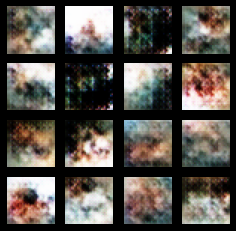

Time for training : 1192 sec


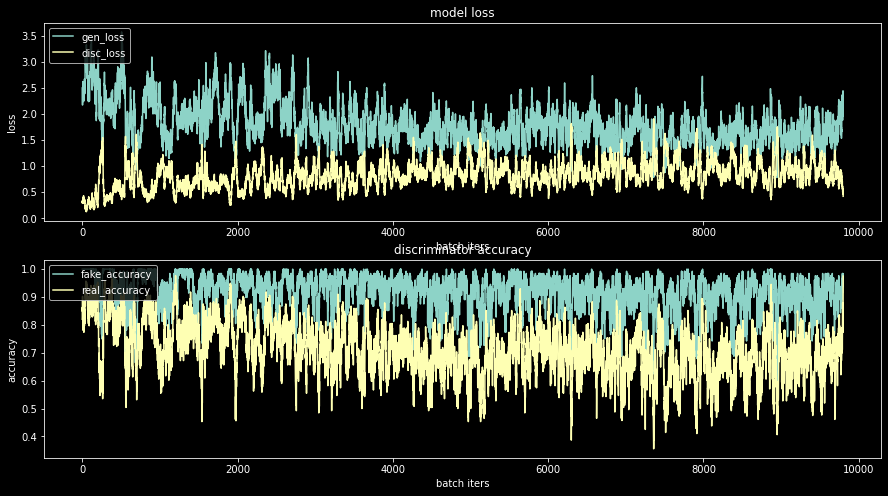

-rw------- 1 root root 1330246 Feb 14 06:45 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_01.gif


In [ ]:
BATCH_SIZE = 128 
noise_dim = 100
save_every = 5
EPOCHS = 50

train(train_dataset, EPOCHS, save_every, 1)

- 진폭(?)이 크다. 에폭이 많아지면 도움이 될 지 모르겠다.

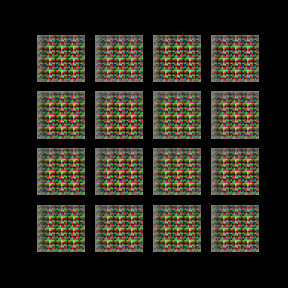

In [ ]:
# gif 확인
from IPython.display import Image
Image(filename="/content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_01.gif")

### 4.3. 2회차 : 학습률 조절
- 역시 쉬운 것 부터
- 학습률 0.0002가 적합하다는 정보를 주웠다. 확인.

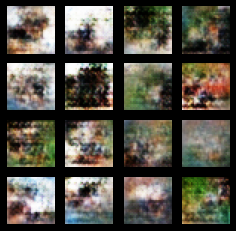

Time for training : 1226 sec


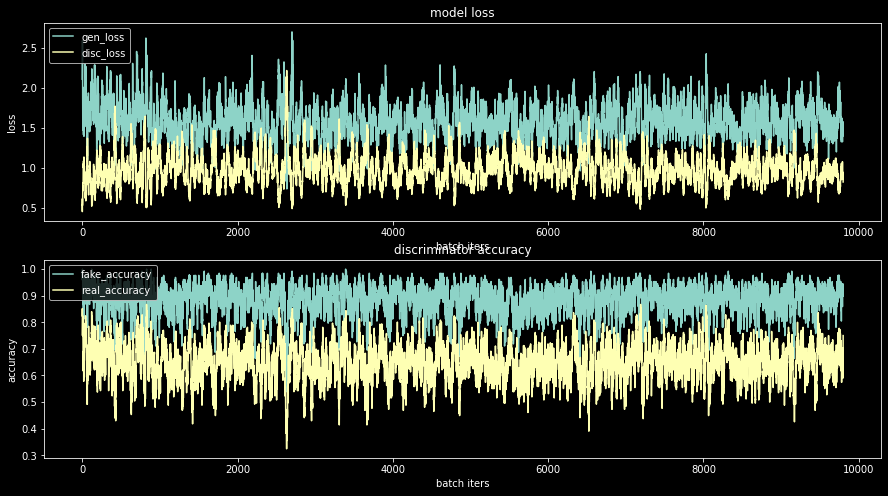

-rw------- 1 root root 1330246 Feb 14 06:45 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_01.gif
-rw------- 1 root root 1303347 Feb 14 07:09 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_02.gif


In [ ]:
generator_optimizer = tf.keras.optimizers.Adam(2e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4)

# 나머지 조건은 위와 동일
train(train_dataset, EPOCHS, save_every, 2)

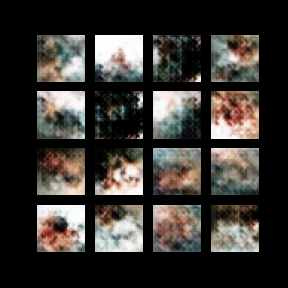

In [ ]:
# gif확인
Image(filename="/content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_02.gif")

초반부의 완전히 윤곽없는 이미지가 확연히(?) 줄어들었다. 소기의 성과가 있었던 것 같다. 이후 이 학습률을 기본으로 하되, 일정 수준의 성과를 얻었을 때 학습률을 원래대로(0.0001) 바꾸어 비교해보겠음.

### 4.4. 3회차 : 생성자 모델의 활성화 함수 Relu 적용해보기.
- 좋은 결과가 기대되지는 않지만 궁금하다.

In [ ]:
# def make_generator_model():

#   model = tf.keras.Sequential()

#   model.add(layers.Dense(4*4*256, use_bias=False, input_shape=(100,)))
#   model.add(layers.BatchNormalization())
#   model.add(layers.LeakyReLU())

#   model.add(layers.Reshape((4, 4, 256)))

#   model.add(layers.Conv2DTranspose(128, kernel_size=(5, 5), strides=(2, 2),   padding='same', use_bias=False))
#   model.add(layers.BatchNormalization())
#   model.add(layers.LeakyReLU())

#   model.add(layers.Conv2DTranspose(64, kernel_size=(5, 5), strides=(2, 2),    padding='same', use_bias=False))
#   model.add(layers.BatchNormalization())
#   model.add(layers.LeakyReLU())

#   # 출력 결과물이 RGB채널을 갖기 위해서 3차원 백터가 필요하다.
#   model.add(layers.Conv2DTranspose(3, kernel_size=(5, 5), strides=(2, 2),     padding='same', use_bias=False, \
#                                    activation='tanh'))

#   return model

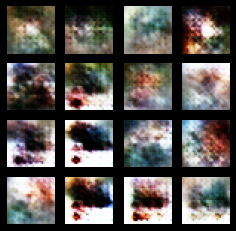

Time for training : 1255 sec


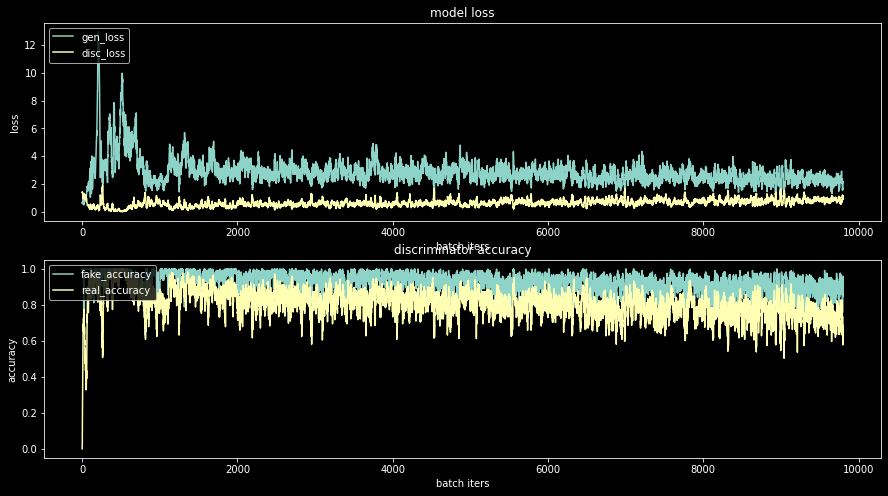

-rw------- 1 root root 1330246 Feb 14 06:45 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_01.gif
-rw------- 1 root root 1303347 Feb 14 07:09 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_02.gif
-rw------- 1 root root 1316609 Feb 14 15:00 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_03.gif


In [ ]:
BATCH_SIZE = 128 
noise_dim = 100
save_every = 5
EPOCHS = 50

generator_optimizer = tf.keras.optimizers.Adam(2e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4)

# 나머지 조건은 위와 동일
train(train_dataset, EPOCHS, save_every, 3)

- 시각적으로나 지표로 보나 개선점은 없는 것으로 보인다.

In [ ]:
# 빠르게 원상복구

def make_generator_model():

  model = tf.keras.Sequential()

  model.add(layers.Dense(4*4*256, use_bias=False, input_shape=(100,)))
  model.add(layers.BatchNormalization())
  model.add(layers.LeakyReLU())

  model.add(layers.Reshape((4, 4, 256)))

  model.add(layers.Conv2DTranspose(128, kernel_size=(5, 5), strides=(2, 2),   padding='same', use_bias=False))
  model.add(layers.BatchNormalization())
  model.add(layers.LeakyReLU())

  model.add(layers.Conv2DTranspose(64, kernel_size=(5, 5), strides=(2, 2),    padding='same', use_bias=False))
  model.add(layers.BatchNormalization())
  model.add(layers.LeakyReLU())

  # 출력 결과물이 RGB채널을 갖기 위해서 3차원 백터가 필요하다.
  model.add(layers.Conv2DTranspose(3, kernel_size=(5, 5), strides=(2, 2),     padding='same', use_bias=False, \
                                   activation='tanh'))

  return model

### 4.5. 4회차 : 판별자 모델의 padding 파라미터 조절
- fashion Mnist나 더 이전의 폐렴 판별 모델에서도 생각했던 점으로, 실질적으로 이미지 외곽 부분의 정보량이 더 적지 않은가 하는 의문이 있었다.
- padding = 'valid'을 판별자의 첫 레이어에만 적용시켜보면 어떨까.

In [ ]:
 def make_discriminator_model():

    model = tf.keras.Sequential()

    # input shape만 조절.
    model.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='valid', input_shape=[32, 32, 3]))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))

    model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))

    model.add(layers.Flatten())

    # 출력은 그대로 1이다.
    model.add(layers.Dense(1))

    return model

In [ ]:
discriminator.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 16, 16, 64)        4864      
                                                                 
 leaky_re_lu_3 (LeakyReLU)   (None, 16, 16, 64)        0         
                                                                 
 dropout (Dropout)           (None, 16, 16, 64)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 8, 8, 128)         204928    
                                                                 
 leaky_re_lu_4 (LeakyReLU)   (None, 8, 8, 128)         0         
                                                                 
 dropout_1 (Dropout)         (None, 8, 8, 128)         0         
                                                                 
 flatten (Flatten)           (None, 8192)             

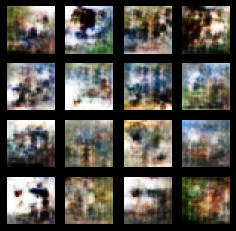

Time for training : 1920 sec


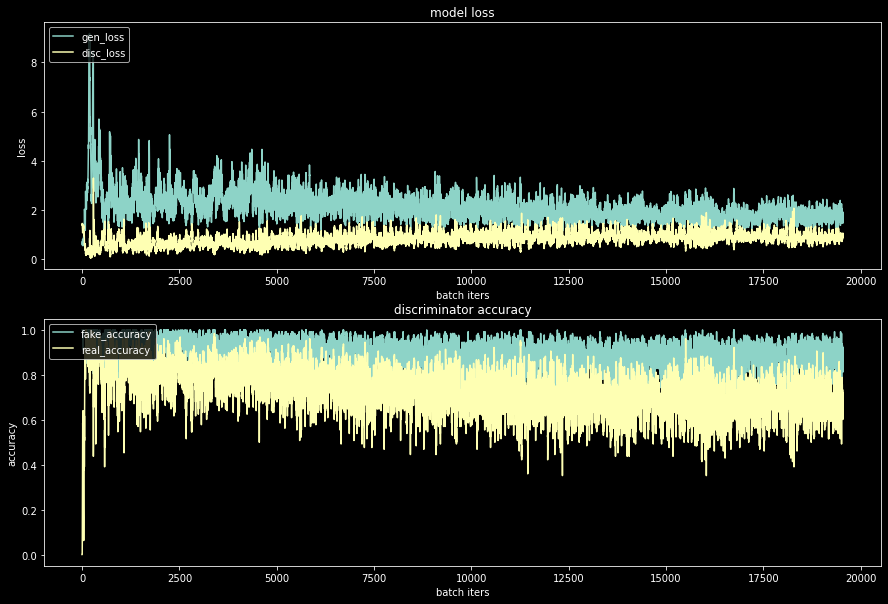

-rw------- 1 root root 1330246 Feb 14 06:45 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_01.gif
-rw------- 1 root root 1303347 Feb 14 07:09 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_02.gif
-rw------- 1 root root 1316609 Feb 14 15:00 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_03.gif
-rw------- 1 root root 1830447 Feb 14 15:44 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_04.gif


In [ ]:
BATCH_SIZE = 128 
noise_dim = 100
save_every = 5
EPOCHS = 50

generator_optimizer = tf.keras.optimizers.Adam(2e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4)

# 나머지 조건은 앞서와 동일
train(train_dataset, EPOCHS, save_every, 4)

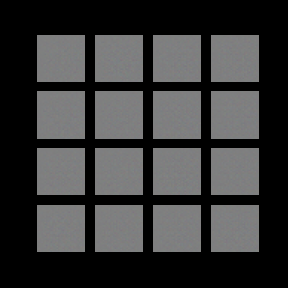

In [ ]:
Image(filename="/content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_04.gif")

- gif를 기준으로는 판별이 어렵지만 학습결과의 16개 샘플은 비교적 물체의 윤곽선이 드러나는 것 같기도 하다.
- 그렇다는 것은 첫 레이어의 padding을 수정한 것이 유효한 효과가 있다는 것일까? 우선 조건을 유지해보자.

### 4.6. 5회차 : 판별자의 드롭아웃 대신 배치노멀라이제이션 사용

In [ ]:
 def make_discriminator_model():

    model = tf.keras.Sequential()

    # input shape만 조절.
    model.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='valid', input_shape=[32, 32, 3]))
    model.add(layers.LeakyReLU())
    model.add(layers.BatchNormalization())

    model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.BatchNormalization())

    model.add(layers.Flatten())

    # 출력은 그대로 1이다.
    model.add(layers.Dense(1))

    return model

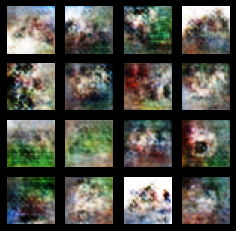

Time for training : 1976 sec


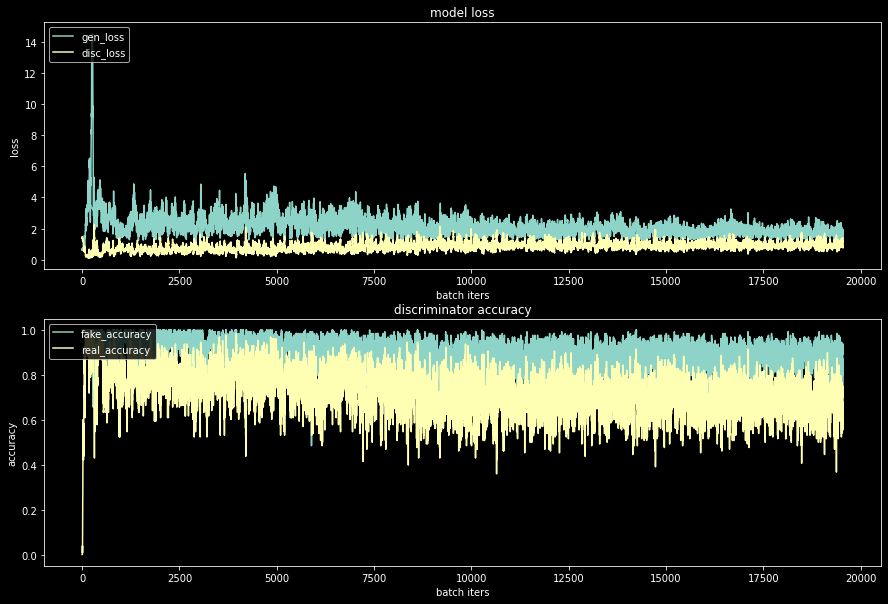

-rw------- 1 root root 1330246 Feb 14 06:45 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_01.gif
-rw------- 1 root root 1303347 Feb 14 07:09 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_02.gif
-rw------- 1 root root 1316609 Feb 14 15:00 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_03.gif
-rw------- 1 root root 1830447 Feb 14 15:44 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_04.gif
-rw------- 1 root root 1849513 Feb 14 16:37 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_05.gif


In [ ]:
BATCH_SIZE = 128 
noise_dim = 100
save_every = 5
EPOCHS = 50

generator_optimizer = tf.keras.optimizers.Adam(2e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4)

# 나머지 조건은 앞서와 동일
train(train_dataset, EPOCHS, save_every, 5)

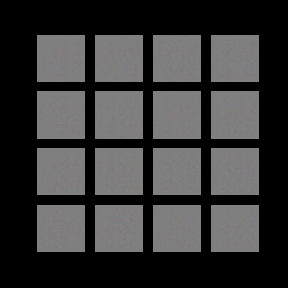

In [ ]:
Image(filename="/content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_05.gif")

### 4.7. 6회차 : 모델의 레이어 추가 및 수정(1)
- DCGAN 모델 연구의 공식 발표 자료를 참조하여 신경망을 수정
- 동일한 조건에서, 생성자의 활성화 함수를 Relu로 재차 확인해 볼 에정

In [ ]:
def make_generator_model():

  model = tf.keras.Sequential()

  model.add(layers.Dense(4*4*512, use_bias=False, input_shape=(100,)))
  model.add(layers.Reshape((4, 4, 512)))

  model.add(layers.Conv2DTranspose(256, kernel_size=(5, 5), strides=(2, 2),   padding='same', use_bias=False))
  model.add(layers.BatchNormalization())
  model.add(layers.LeakyReLU())

  model.add(layers.Conv2DTranspose(128, kernel_size=(5, 5), strides=(2, 2),    padding='same', use_bias=False))
  model.add(layers.BatchNormalization())
  model.add(layers.LeakyReLU())

  # 출력 결과물이 RGB채널을 갖기 위해서 3차원 백터가 필요하다.
  model.add(layers.Conv2DTranspose(3, kernel_size=(5, 5), strides=(2, 2),     padding='same', use_bias=False, \
                                   activation='tanh'))

  return model

In [ ]:
generator = make_generator_model()
generator.summary()

Model: "sequential_19"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_19 (Dense)            (None, 8192)              819200    
                                                                 
 reshape_7 (Reshape)         (None, 4, 4, 512)         0         
                                                                 
 conv2d_transpose_21 (Conv2D  (None, 8, 8, 256)        3276800   
 Transpose)                                                      
                                                                 
 batch_normalization_41 (Bat  (None, 8, 8, 256)        1024      
 chNormalization)                                                
                                                                 
 leaky_re_lu_51 (LeakyReLU)  (None, 8, 8, 256)         0         
                                                                 
 conv2d_transpose_22 (Conv2D  (None, 16, 16, 128)    

In [ ]:
 def make_discriminator_model():

    model = tf.keras.Sequential()

    # input shape만 조절.
    model.add(layers.Conv2D(64, (5, 5),  padding='valid', input_shape=[32, 32, 3]))
    model.add(layers.LeakyReLU())
    model.add(layers.BatchNormalization())

    model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.BatchNormalization())

    model.add(layers.Conv2D(256, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.BatchNormalization())

    model.add(layers.Conv2D(512, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.BatchNormalization())

    model.add(layers.Flatten())

    # 출력은 그대로 1이다.
    model.add(layers.Dense(1))

    return model

In [ ]:
discriminator = make_discriminator_model()
discriminator.summary()

Model: "sequential_15"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_26 (Conv2D)          (None, 28, 28, 64)        4864      
                                                                 
 leaky_re_lu_40 (LeakyReLU)  (None, 28, 28, 64)        0         
                                                                 
 batch_normalization_32 (Bat  (None, 28, 28, 64)       256       
 chNormalization)                                                
                                                                 
 conv2d_27 (Conv2D)          (None, 14, 14, 128)       204928    
                                                                 
 leaky_re_lu_41 (LeakyReLU)  (None, 14, 14, 128)       0         
                                                                 
 batch_normalization_33 (Bat  (None, 14, 14, 128)      512       
 chNormalization)                                    

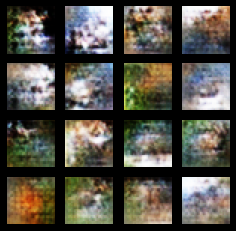

Time for training : 2009 sec


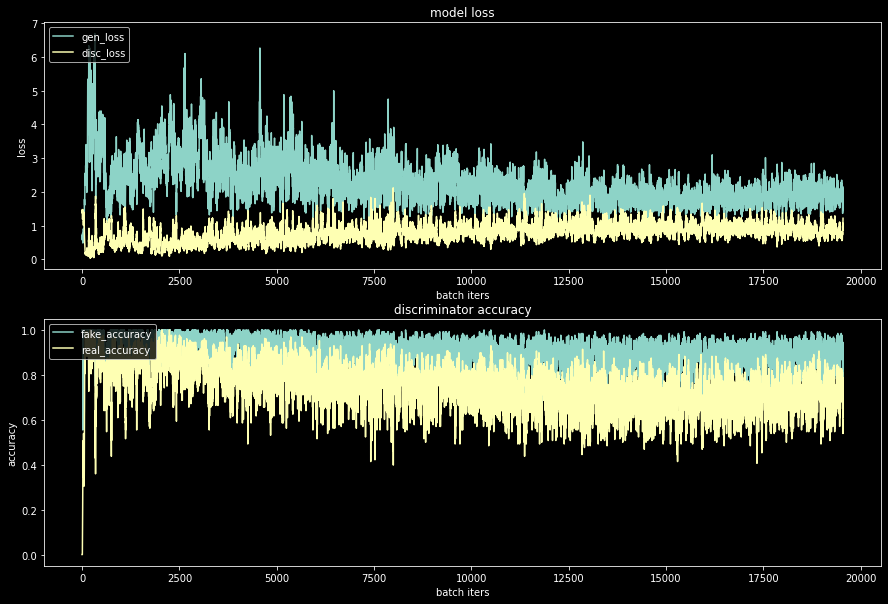

-rw------- 1 root root 1330246 Feb 14 06:45 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_01.gif
-rw------- 1 root root 1303347 Feb 14 07:09 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_02.gif
-rw------- 1 root root 1316609 Feb 14 15:00 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_03.gif
-rw------- 1 root root 1830447 Feb 14 15:44 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_04.gif
-rw------- 1 root root 1849513 Feb 14 16:37 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_05.gif
-rw------- 1 root root 1842570 Feb 14 17:45 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_06.gif


In [ ]:
BATCH_SIZE = 128 
noise_dim = 100
save_every = 5
EPOCHS = 50

generator_optimizer = tf.keras.optimizers.Adam(2e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4)

# 나머지 조건은 앞서와 동일
train(train_dataset, EPOCHS, save_every, 6)

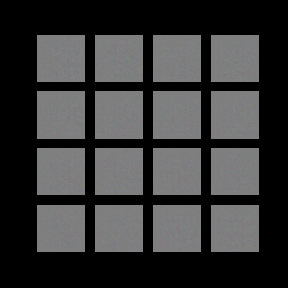

In [ ]:
Image(filename="/content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_06.gif")

### 4.8. 7회차 : 모델의 레이어 추가 및 수정(2)
- 생성자 모델의 활성화 함수를 Relu로 두고 비교

In [ ]:
def make_generator_model():

  model = tf.keras.Sequential()

  model.add(layers.Dense(4*4*512, use_bias=False, input_shape=(100,)))
  model.add(layers.Reshape((4, 4, 512)))

  model.add(layers.Conv2DTranspose(256, kernel_size=(5, 5), strides=(2, 2),   padding='same', use_bias=False))
  model.add(layers.BatchNormalization())
  model.add(layers.ReLU())

  model.add(layers.Conv2DTranspose(128, kernel_size=(5, 5), strides=(2, 2),    padding='same', use_bias=False))
  model.add(layers.BatchNormalization())
  model.add(layers.ReLU())

  # 출력 결과물이 RGB채널을 갖기 위해서 3차원 백터가 필요하다.
  model.add(layers.Conv2DTranspose(3, kernel_size=(5, 5), strides=(2, 2),     padding='same', use_bias=False, \
                                   activation='tanh'))

  return model

In [ ]:
generator = make_generator_model()
generator.summary()

Model: "sequential_20"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_20 (Dense)            (None, 8192)              819200    
                                                                 
 reshape_8 (Reshape)         (None, 4, 4, 512)         0         
                                                                 
 conv2d_transpose_24 (Conv2D  (None, 8, 8, 256)        3276800   
 Transpose)                                                      
                                                                 
 batch_normalization_43 (Bat  (None, 8, 8, 256)        1024      
 chNormalization)                                                
                                                                 
 re_lu (ReLU)                (None, 8, 8, 256)         0         
                                                                 
 conv2d_transpose_25 (Conv2D  (None, 16, 16, 128)    

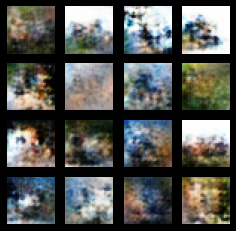

Time for training : 1928 sec


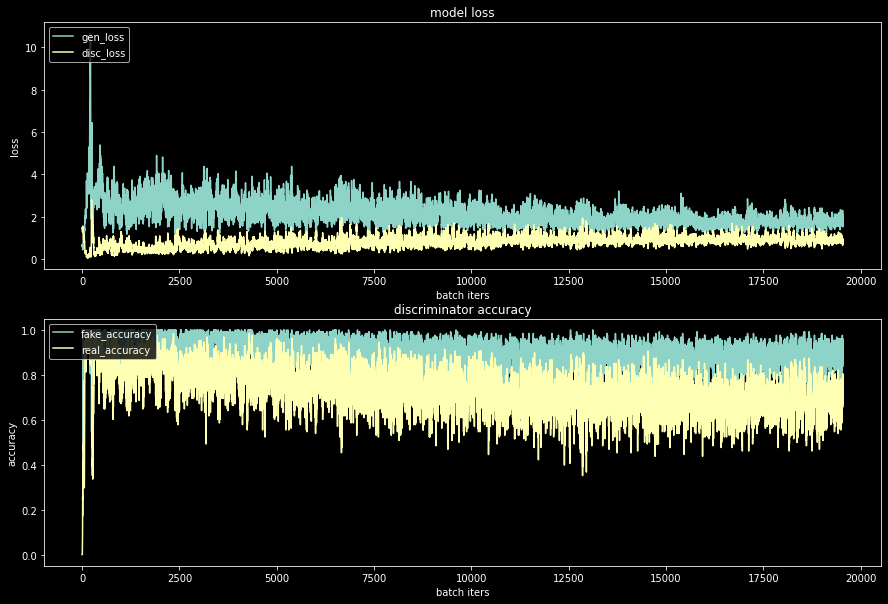

-rw------- 1 root root 1330246 Feb 14 06:45 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_01.gif
-rw------- 1 root root 1303347 Feb 14 07:09 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_02.gif
-rw------- 1 root root 1316609 Feb 14 15:00 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_03.gif
-rw------- 1 root root 1830447 Feb 14 15:44 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_04.gif
-rw------- 1 root root 1849513 Feb 14 16:37 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_05.gif
-rw------- 1 root root 1842570 Feb 14 17:45 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_06.gif
-rw------- 1 root root 1827056 Feb 14 18:23 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_07.gif


In [ ]:
BATCH_SIZE = 128 
noise_dim = 100
save_every = 5
EPOCHS = 50

generator_optimizer = tf.keras.optimizers.Adam(2e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4)

# 나머지 조건은 앞서와 동일
train(train_dataset, EPOCHS, save_every, 7)

### 4.8.1. epoch 추가
- 앞서 모델들과 달리 지표의 증감이 어느 정도 가시적으로 확인된다. 
- 학습을 조금 더 진행해보자.

In [ ]:
checkpoint_dir = '/content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/training_checkpoints'

latest = tf.train.latest_checkpoint(checkpoint_dir)
checkpoint.restore(latest)

generator = checkpoint.generator
discriminator = checkpoint.discriminator

# 로드한 모델이 정상적으로 이미지를 생성하는지 확인해 봅니다. 
noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)

np_generated = generated_image.numpy()
np_generated = (np_generated * 127.5) + 127.5   # reverse of normalization
np_generated = np_generated.astype(int)
plt.imshow(np_generated[0])
plt.show()  # 정상적으로 모델이 로드되었다면 랜덤 이미지가 아니라 CIFAR-10 이미지가 그려질 것입니다.

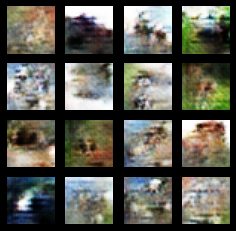

Time for training : 1944 sec


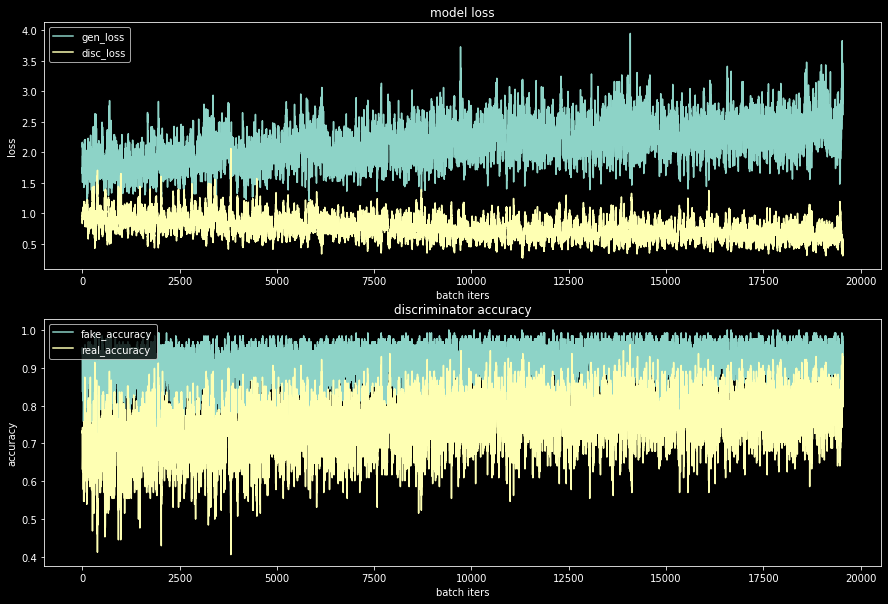

-rw------- 1 root root 1330246 Feb 14 06:45 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_01.gif
-rw------- 1 root root 1303347 Feb 14 07:09 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_02.gif
-rw------- 1 root root 1316609 Feb 14 15:00 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_03.gif
-rw------- 1 root root 1830447 Feb 14 15:44 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_04.gif
-rw------- 1 root root 1849513 Feb 14 16:37 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_05.gif
-rw------- 1 root root 1842570 Feb 14 17:45 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_06.gif
-rw------- 1 root root 1799055 Feb 14 19:07 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_07.gif
CPU times: user 31min 53s, sys: 46.2 s, total: 32min 40s
Wall time: 32min 32s


In [ ]:
%%time
train(train_dataset, EPOCHS, save_every, 7)

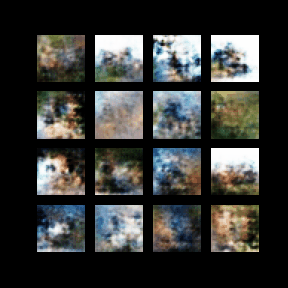

In [ ]:
Image(filename="/content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_07.gif")

### 4.9. 8회차 : 생성자 모델 drop out(0.5) 추가
- 댄스레이어에 약간 변화를 주었음.
- conv레이어에 활성화함수 relu를 사용함. 바로 다음 시도에 다시 변경해볼 것.
- 훨씬 많은 epoch을 실행했고 비교적 윤곽이 보이는 것 같다.

In [ ]:
def make_generator_model():

  model = tf.keras.Sequential()

  model.add(layers.Dense(4*4*512, use_bias=False, input_shape=(100,)))
  model.add(layers.Reshape((4, 4, 512)))
  model.add(layers.BatchNormalization())
  model.add(layers.LeakyReLU())

  model.add(layers.Conv2DTranspose(256, kernel_size=(5, 5), strides=(2, 2),   padding='same', use_bias=False))
  model.add(layers.BatchNormalization())
  model.add(layers.ReLU())
  model.add(layers.Dropout(0.5))

  model.add(layers.Conv2DTranspose(128, kernel_size=(5, 5), strides=(2, 2),    padding='same', use_bias=False))
  model.add(layers.BatchNormalization())
  model.add(layers.ReLU())
  model.add(layers.Dropout(0.5))

  # 출력 결과물이 RGB채널을 갖기 위해서 3차원 백터가 필요하다.
  model.add(layers.Conv2DTranspose(3, kernel_size=(5, 5), strides=(2, 2),     padding='same', use_bias=False, \
                                   activation='tanh'))

  return model

In [ ]:
generator = make_generator_model()
generator.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_2 (Dense)             (None, 8192)              819200    
                                                                 
 reshape_1 (Reshape)         (None, 4, 4, 512)         0         
                                                                 
 batch_normalization_3 (Batc  (None, 4, 4, 512)        2048      
 hNormalization)                                                 
                                                                 
 leaky_re_lu_5 (LeakyReLU)   (None, 4, 4, 512)         0         
                                                                 
 conv2d_transpose_3 (Conv2DT  (None, 8, 8, 256)        3276800   
 ranspose)                                                       
                                                                 
 batch_normalization_4 (Batc  (None, 8, 8, 256)       

In [ ]:
 def make_discriminator_model():

    model = tf.keras.Sequential()

    # input shape만 조절.
    model.add(layers.Conv2D(64, (5, 5), padding='valid', input_shape=[32, 32, 3]))
    model.add(layers.LeakyReLU())
    model.add(layers.BatchNormalization())

    model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.BatchNormalization())

    model.add(layers.Conv2D(256, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.BatchNormalization())

    model.add(layers.Conv2D(512, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.BatchNormalization())

    model.add(layers.Flatten())

    model.add(layers.Dense(1))

    return model

In [ ]:
discriminator = make_discriminator_model()
discriminator.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 28, 28, 64)        4864      
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 28, 28, 64)        0         
                                                                 
 batch_normalization_2 (Batc  (None, 28, 28, 64)       256       
 hNormalization)                                                 
                                                                 
 conv2d_1 (Conv2D)           (None, 14, 14, 128)       204928    
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 14, 14, 128)       0         
                                                                 
 batch_normalization_3 (Batc  (None, 14, 14, 128)      512       
 hNormalization)                                      

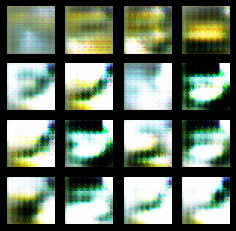

Epoch 43 | iter 51
Time for epoch 43 : 20 sec


In [ ]:
BATCH_SIZE = 128 
noise_dim = 100
save_every = 5
EPOCHS = 55

generator_optimizer = tf.keras.optimizers.Adam(2e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4)

# 나머지 조건은 앞서와 동일
train(train_dataset, EPOCHS, save_every, 8)

In [ ]:
BATCH_SIZE = 128 
noise_dim = 100
save_every = 5
EPOCHS = 70

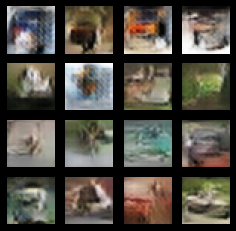

Time for training : 1244 sec


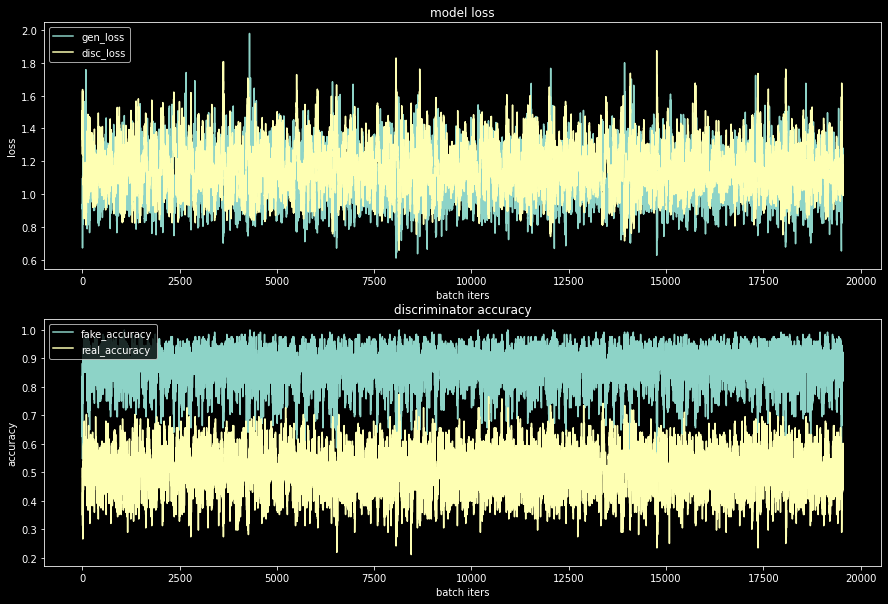

-rw------- 1 root root 1330246 Feb 14 06:45 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_01.gif
-rw------- 1 root root 1303347 Feb 14 07:09 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_02.gif
-rw------- 1 root root 1316609 Feb 14 15:00 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_03.gif
-rw------- 1 root root 1830447 Feb 14 15:44 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_04.gif
-rw------- 1 root root 1849513 Feb 14 16:37 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_05.gif
-rw------- 1 root root 1842570 Feb 14 17:45 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_06.gif
-rw------- 1 root root 1799055 Feb 14 19:07 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_07.gif
-rw------- 1 root root 2001474 Feb 15 12:44 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_08.gif
CPU times: user 20min 30s, sys: 25.8 s, total: 20min 55s
Wall time: 20min 50s


In [78]:
%%time
train(train_dataset, 50, save_every, 8)

In [76]:
len(os.listdir(path + '/generated_samples'))

565

In [ ]:
os.listdir(path + '/generated_samples')[0]

'sample_epoch_0050_iter_195.png'

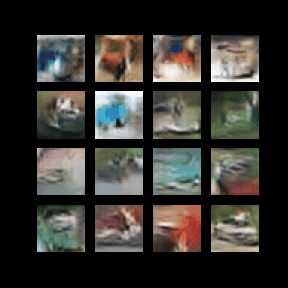

In [97]:
Image(filename="/content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_08.gif")

### 4.10. 9회차 : 8회차 + 활성화함수 모두 LeakyRelu

In [79]:
def make_generator_model():

  model = tf.keras.Sequential()

  model.add(layers.Dense(4*4*512, use_bias=False, input_shape=(100,)))
  model.add(layers.Reshape((4, 4, 512)))
  model.add(layers.BatchNormalization())
  model.add(layers.LeakyReLU())

  model.add(layers.Conv2DTranspose(256, kernel_size=(5, 5), strides=(2, 2),   padding='same', use_bias=False))
  model.add(layers.BatchNormalization())
  model.add(layers.LeakyReLU())
  model.add(layers.Dropout(0.5))

  model.add(layers.Conv2DTranspose(128, kernel_size=(5, 5), strides=(2, 2),    padding='same', use_bias=False))
  model.add(layers.BatchNormalization())
  model.add(layers.LeakyReLU())
  model.add(layers.Dropout(0.5))

  # 출력 결과물이 RGB채널을 갖기 위해서 3차원 백터가 필요하다.
  model.add(layers.Conv2DTranspose(3, kernel_size=(5, 5), strides=(2, 2),     padding='same', use_bias=False, \
                                   activation='tanh'))

  return model

In [80]:
generator = make_generator_model()
generator.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_3 (Dense)             (None, 8192)              819200    
                                                                 
 reshape_2 (Reshape)         (None, 4, 4, 512)         0         
                                                                 
 batch_normalization_6 (Batc  (None, 4, 4, 512)        2048      
 hNormalization)                                                 
                                                                 
 leaky_re_lu_6 (LeakyReLU)   (None, 4, 4, 512)         0         
                                                                 
 conv2d_transpose_6 (Conv2DT  (None, 8, 8, 256)        3276800   
 ranspose)                                                       
                                                                 
 batch_normalization_7 (Batc  (None, 8, 8, 256)       

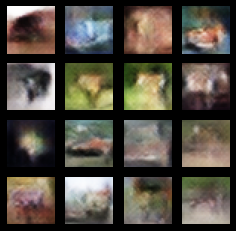

Time for training : 3900 sec


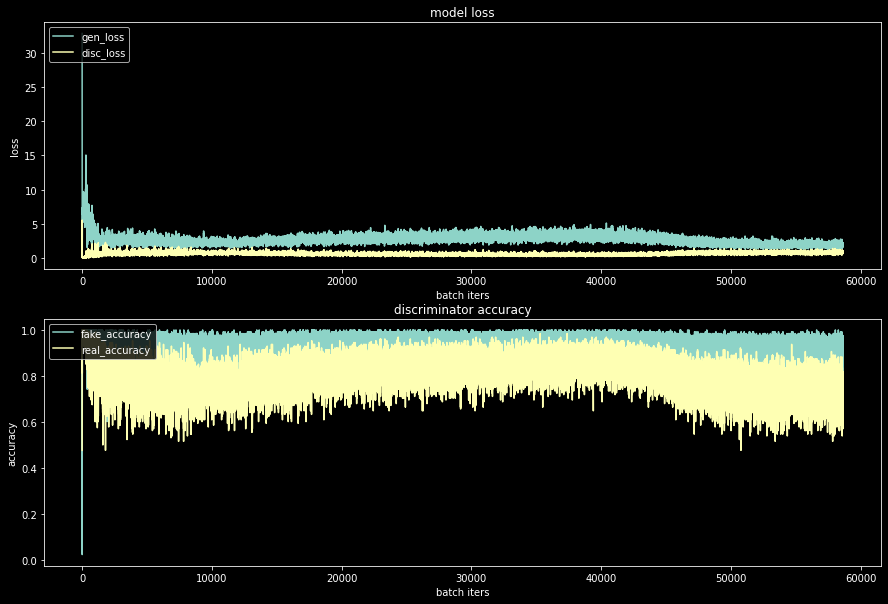

-rw------- 1 root root 1330246 Feb 14 06:45 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_01.gif
-rw------- 1 root root 1303347 Feb 14 07:09 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_02.gif
-rw------- 1 root root 1316609 Feb 14 15:00 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_03.gif
-rw------- 1 root root 1830447 Feb 14 15:44 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_04.gif
-rw------- 1 root root 1849513 Feb 14 16:37 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_05.gif
-rw------- 1 root root 1842570 Feb 14 17:45 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_06.gif
-rw------- 1 root root 1799055 Feb 14 19:07 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_07.gif
-rw------- 1 root root 2001474 Feb 15 12:44 /content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_08.gif
-rw------- 1 root root 3026469 Feb 15 13:57 /content/drive/MyDrive/Aiffel/Exploration/E-

In [96]:
BATCH_SIZE = 128 
noise_dim = 100
save_every = 5
EPOCHS = 150

generator_optimizer = tf.keras.optimizers.Adam(2e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4)

# 나머지 조건은 앞서와 동일
train(train_dataset, EPOCHS, save_every, 9)

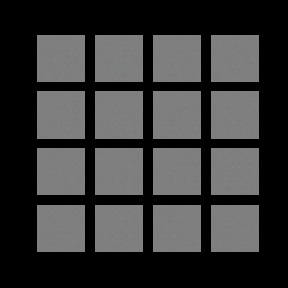

In [98]:
Image(filename="/content/drive/MyDrive/Aiffel/Exploration/E-10/cifar10/try/try_09.gif")

## 5. 마치며

### 기억에 남는 학습 내용
- 모델 구성, 학습, 학습과정에 대해 개별로 작성된 코드
- GAN모델의 발상 그 자체
- danse레이어와 reshape레이어를 통해 노이즈를 생성한 점


### 어려웠던 점
- 모델 구성, 학습, 학습과정에 대해 개별로 작성된 코드
    > 기억에 남고 배울만한 부분이지만 프로젝트를 시작하는 단계에서는 코드를 다시 확인하고 읽는 데에 시간이 오래걸렸다.

- 시간이 오래걸렸다, 50epoch으로 결과 개선이 거의 없어서 효과가 없다고만 생각하고 다른 방식을 찾아 헤매었는데, 기본적으로 더 많은 학습량이 필요했던 것 같다.

- 이전 폐렴 진단 모델에서 LMS에 상처받고 코랩을 사용했다. 적응하는 시간이 필요했다.

- 두 번이나 GPU권한을 빼앗겼다. 과정 전체를 LMS로 이전하기에는 너무 번거롭게 느껴졌고, LMS 사용 자체에 회의감이(..) 들고.. 시간 낭비가 컸다.


### 추가로 해보고 싶은 점
- 모델에 대해 뭔가를 더 해보고 싶다는 감각을 느끼기에는 너무 효과가 없었다.
- 결과적으로 코랩프로를 결재했는데, 코랩 프로보다 두 배 정도 속도가 나온다면 많은 학습을 시켜보면서 이미지를 생성해보고 싶기도하다.


### 총평
: LMS에서 다친 마음, 코랩이 반대쪽 뺨까지 시원하게 쳐준 느낌(..)

나, 이제, 코랩 프로 권한 오너

모델 구성의 문제일수도 있지만, 유의미한 변화를 얻기까지 실습 기준이었던 50보다 훨씬 많은 학습이 필요하다는 것이 다른 아이펠 동료들의 일반적인 견해였다. 

*솔찍히 이 정도의 단서는 프로젝트에 앞서 제공해주면 좋겠다는 생각이..*

많은 문제가 있었고.. 학습 과정이 유쾌하지는 못했지만, 처음 접한 GAN모델의 발상이 대단하다고 생각했다. 

원본데이터나 목표에 대해, '컴퓨터적 사고'를 할 수 있게되면 이 분야의 공부가 더 재밌어질 것 같다.


